In [1]:
DEBUG = False

In [2]:
import sys
sys.path.append('../HPA-competition-solutions/bestfitting/src/')

In [3]:
import time
import pretrainedmodels
import skimage.io
import numpy as np
import pandas as pd
import cv2
import PIL.Image
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.utils.data import DataLoader, Dataset
from torch.utils.data.sampler import SubsetRandomSampler, RandomSampler, SequentialSampler
from warmup_scheduler import GradualWarmupScheduler
from efficientnet_pytorch import model as enet
import albumentations
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import cohen_kappa_score
from tqdm import tqdm_notebook as tqdm
import os
import warnings
import cv2
from sklearn.metrics import average_precision_score
import pickle

warnings.filterwarnings('ignore') 

In [4]:
from config.config import *
from networks.densenet import *
from datasets.tool import *
from torch.utils.data import Dataset
import pandas as pd
import torchvision
import torch
import cv2
import os

import time
import shutil
from sklearn.metrics import f1_score

import torch
import torch.optim
from torch.utils.data import DataLoader
from torch.utils.data.sampler import RandomSampler, SequentialSampler
from torch.nn import DataParallel
from torch.backends import cudnn
import torch.nn.functional as F
from torch.autograd import Variable

from config.config import *
from utils.common_util import *
from networks.imageclsnet import init_network
from datasets.protein_dataset import ProteinDataset
from utils.augment_util import train_multi_augment2
from layers.loss import *
from layers.scheduler import *
from utils.log_util import Logger

run on pazur


In [5]:
kernel_type = 'pudae_xc1'

fold = 0
image_size = 1024
# crop_size = 512
batch_size = 8
ITERS_TO_ACCUMULATE = 4
num_workers = 8
out_dim = 19
init_lr = 3e-3
warmup_factor = 10
nfold = 2 if DEBUG else 5
seed = 42
test_image_size = 128
n_epochs = 3 if DEBUG else 5

device = torch.device('cuda')

## Model

In [6]:
class AttentionInceptionV3(nn.Module):
    def __init__(self, num_classes=28, attention_size=8, aux_attention_size=8):
        super().__init__()
        self.num_classes = num_classes
        self.cnn = torchvision.models.inception_v3(pretrained=False)
        self.attention_size = attention_size
        self.aux_attention_size = aux_attention_size

        conv = self.cnn.Conv2d_1a_3x3.conv
        self.cnn.Conv2d_1a_3x3.conv = nn.Conv2d(in_channels=4,
                                                out_channels=conv.out_channels,
                                                kernel_size=conv.kernel_size,
                                                stride=conv.stride,
                                                padding=conv.padding,
                                                bias=conv.bias)

        # copy pretrained weights
        self.cnn.Conv2d_1a_3x3.conv.weight.data[:,:3,:,:] = conv.weight.data
        self.cnn.Conv2d_1a_3x3.conv.weight.data[:,3:,:,:] = conv.weight.data[:,:1,:,:]

        self.features_a = nn.Sequential(
            self.cnn.Conv2d_1a_3x3,
            self.cnn.Conv2d_2a_3x3,
            self.cnn.Conv2d_2b_3x3,
            nn.MaxPool2d(kernel_size=3, stride=2),
            self.cnn.Conv2d_3b_1x1,
            self.cnn.Conv2d_4a_3x3,
            nn.MaxPool2d(kernel_size=3, stride=2),
            self.cnn.Mixed_5b,
            self.cnn.Mixed_5c,
            self.cnn.Mixed_5d,
            self.cnn.Mixed_6a,
            self.cnn.Mixed_6b,
            self.cnn.Mixed_6c,
            self.cnn.Mixed_6d,
            self.cnn.Mixed_6e,
        )

        self.features_b = nn.Sequential(
            self.cnn.Mixed_7a,
            self.cnn.Mixed_7b,
            self.cnn.Mixed_7c,
        )

        self.aux_avgpool = nn.AdaptiveAvgPool2d(self.aux_attention_size)
        aux_in_features = self.cnn.AuxLogits.fc.in_features
        self.aux_linear = nn.Conv2d(aux_in_features, self.num_classes, kernel_size=1, padding=0)
        self.aux_attention = nn.Conv2d(aux_in_features, self.num_classes, kernel_size=1, padding=0)

        self.avgpool = nn.AdaptiveAvgPool2d(self.attention_size)
        in_features = self.cnn.fc.in_features
        self.last_linear = nn.Conv2d(in_features, self.num_classes, kernel_size=1, padding=0)
        self.attention = nn.Conv2d(in_features, self.num_classes, kernel_size=1, padding=0)

    def forward(self, x, masks):
        features_a = self.features_a(x)
        if self.training:
            if self.aux_attention_size != features_a.size(-1):
                aux_features = self.aux_avgpool(features_a)
            else:
                aux_features = features_a
            aux_logits = self.aux_linear(aux_features)
            assert aux_logits.size(1) == self.num_classes and \
                   aux_logits.size(2) == self.aux_attention_size and \
                   aux_logits.size(3) == self.aux_attention_size
            aux_logits_attention = self.aux_attention(aux_features)
            assert aux_logits_attention.size(1) == self.num_classes and \
                   aux_logits_attention.size(2) == self.aux_attention_size and \
                   aux_logits_attention.size(3) == self.aux_attention_size
            aux_logits_attention = aux_logits_attention.view(
                -1, self.num_classes,
                self.aux_attention_size * self.aux_attention_size)
            aux_attention = F.softmax(aux_logits_attention, dim=2)
            aux_attention = aux_attention.view(
                -1, self.num_classes, self.aux_attention_size, self.aux_attention_size)
            aux_logits = aux_logits * aux_attention
            aux_logits = aux_logits.view(
                -1, self.num_classes,
                self.aux_attention_size * self.aux_attention_size).sum(2).view(-1, self.num_classes)

        features_b = self.features_b(features_a)

        if self.aux_attention_size != features_b.size(-1):
            features_b = self.avgpool(features_b)
        logits = self.last_linear(features_b)
        logits = F.interpolate(logits, scale_factor=3, mode='nearest')

        logits_attention = self.attention(features_b)
        logits_attention = F.interpolate(logits_attention, scale_factor=3, mode='nearest')
        
        logits_attention = logits_attention.view(-1, self.num_classes, self.attention_size * 3 * self.attention_size * 3)
        attention = F.softmax(logits_attention, dim=2)
        attention = attention.view(-1, self.num_classes, self.attention_size * 3, self.attention_size * 3)
        attention = attention.permute(0,2,3,1) # [1,32,32,19])
        msk = masks.squeeze() # [15,32,32]       
        attention = msk[...,None] * attention # [15,32,32,19]
        attention = attention.permute(0,3,1,2) # [15,19,32,32]
        attention = attention.view(-1, self.num_classes, self.attention_size * 3 * self.attention_size * 3) #[15, 19, 1024]
        attention = attention / (attention.sum(2).unsqueeze(-1) + 1e-7)
        attention = attention.view(-1, self.num_classes, self.attention_size * 3, self.attention_size * 3) #[15,19,32,32]
        logits = logits * attention
        return logits.view(-1, self.num_classes, self.attention_size * 3 * self.attention_size * 3).sum(2).view(-1, self.num_classes) # torch.Size([1, 19])

In [7]:
model = AttentionInceptionV3(num_classes=19, attention_size=22, aux_attention_size=46)
inp = torch.zeros((1,4,768,768))
masks = torch.zeros((1,15,66,66))
model.eval()
out = model(inp, masks)
# out[0].shape, out[1].shape
out.shape

torch.Size([15, 19])

In [8]:
def get_model():
    
    num_classes=19
    model = AttentionInceptionV3(num_classes=19, attention_size=22, aux_attention_size=46)
    
    model_file = '../pudae_models/inceptionv3.attention.policy.per_image_norm.1024/checkpoint/swa.10.027.pth'
    weights = torch.load(model_file)
    pretrained_dict = weights['state_dict']
    model_dict = model.state_dict()

    # 1. filter out unnecessary keys
    pretrained_dict = {k: v for k, v in pretrained_dict.items() if k not in [
        'last_linear.weight', 'last_linear.bias', 'aux_linear.weight', \
        'aux_linear.bias', 'attention.weight', 'attention.bias', 'aux_attention.weight', 'aux_attention.bias']}
    # 2. overwrite entries in the existing state dict
    model_dict.update(pretrained_dict)
    # 3. load the new state dict
    model.load_state_dict(model_dict)

    i = 0
    for child in model.cnn.children():
        if i < 20:
            for param in child.parameters():
                param.requires_grad = False
        i += 1
    return model

In [9]:
def get_model_test():
    model = AttentionInceptionV3(num_classes=19, attention_size=22, aux_attention_size=46)
    return model

In [10]:
def open_rgby(fpath, yellow=True): #a function that reads RGBY image    
    if yellow: colors = ['red','green','blue','yellow']
    else: colors = ['red','green','blue']
    flags = cv2.IMREAD_GRAYSCALE
    img = [cv2.imread(fpath+'_'+color+'.png', flags) for color in colors]
    
    return np.stack(img, axis=-1)

## Augmentations

In [11]:
mean = [0.074598, 0.050630, 0.050891, 0.076287]#rgby
std =  [0.122813, 0.085745, 0.129882, 0.119411]

transforms_test = albumentations.Compose([
    albumentations.Resize(image_size, image_size, p=1.),
#     albumentations.Normalize(mean=mean, std=std)
])


In [12]:
class UnNormalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std
    def __call__(self, tensor):
        for t, m, s in zip(tensor, self.mean, self.std):
            t.mul_(s).add_(m)
        return torch.clamp(tensor,0.,1.)

In [13]:
def tensor2label(t):
    l = t.numpy().tolist()
    l = [i for i,v in enumerate(l) if v==1.]
    return str(l)
label = torch.tensor(np.array([1.,0,1,0]))
tensor2label(label)

'[0, 2]'

## Mask dataset

In [14]:
def read_rgby_test(img_id):
    img_dir = '../full_test/test'
    msk_dir = '../test_masks/work/cell_masks'
    suffix = '.png'
    colors = ['red', 'green', 'blue', 'yellow']
    flags = cv2.IMREAD_GRAYSCALE
    img = [cv2.imread(opj(img_dir, img_id + '_' + color + suffix), flags)
           for color in colors]
    img = np.stack(img, axis=-1)
    msk = np.load(opj(msk_dir, img_id + '.npz'))['arr_0'].astype('int8')
    return img, msk

In [15]:
import base64
import numpy as np
from pycocotools import _mask as coco_mask
import typing as t
import zlib


def encode_binary_mask(mask: np.ndarray) -> t.Text:
  """Converts a binary mask into OID challenge encoding ascii text."""

  # check input mask --
  if mask.dtype != np.bool:
    raise ValueError(
        "encode_binary_mask expects a binary mask, received dtype == %s" %
        mask.dtype)

  mask = np.squeeze(mask)
  if len(mask.shape) != 2:
    raise ValueError(
        "encode_binary_mask expects a 2d mask, received shape == %s" %
        mask.shape)

  # convert input mask to expected COCO API input --
  mask_to_encode = mask.reshape(mask.shape[0], mask.shape[1], 1)
  mask_to_encode = mask_to_encode.astype(np.uint8)
  mask_to_encode = np.asfortranarray(mask_to_encode)

  # RLE encode mask --
  encoded_mask = coco_mask.encode(mask_to_encode)[0]["counts"]

  # compress and base64 encoding --
  binary_str = zlib.compress(encoded_mask, zlib.Z_BEST_COMPRESSION)
  base64_str = base64.b64encode(binary_str)
  return base64_str.decode('ascii')

In [16]:
def encodings_from_mask(mask):
    encs = []
    for j in range(1, np.max(mask) + 1):
        bmask = (mask == j)
        enc = encode_binary_mask(bmask)
        encs.append(enc)
    return encs

In [17]:
def convert_mask(mask):
    bmask = np.zeros((np.max(mask), mask.shape[0], mask.shape[1]))
    for j in range(1, np.max(mask) + 1):
        bmask[j-1] = (mask == j)
    return bmask    

In [18]:
class ProteinTestDataset(Dataset):
    def __init__(self,
                 test_df,
                 img_size=512,
                 transform=None,
                 in_channels=4,
                 return_encodings=False
                 ):
        self.test_df = test_df
        self.img_size = img_size
        self.in_channels = in_channels
        self.transform = transform
        self.return_encodings = return_encodings

    def __getitem__(self, index):
        img_id = self.test_df.ID.loc[index]
        image, mask = read_rgby_test(img_id)
        if self.transform is not None:
            image = self.transform(image=image)['image']
        image = image.astype(np.float32)
        mean = np.mean(image.reshape(-1, 4), axis=0)
        std = np.std(image.reshape(-1, 4), axis=0)
        image -= mean
        image /= (std + 0.0000001)
        image = image.transpose(2, 0, 1)
        image = torch.tensor(image)
        if self.return_encodings:
            encs = encodings_from_mask(mask)
        mask = cv2.resize(mask, (1024,1024), interpolation=cv2.INTER_NEAREST)
        mask = convert_mask(mask)
        mask = mask.transpose(1,2,0)
        mask = cv2.resize(mask, (66,66), interpolation=cv2.INTER_NEAREST)
        mask = mask.transpose(2,0,1)
        mask = torch.Tensor(mask)
        if self.return_encodings:
            return {
                'image': image, 
                'mask': mask,
                'encoding': encs,
            }
        return {
            'image': image, 
            'mask': mask,
        }

    def __len__(self):
        return len(self.test_df)

In [19]:
df = pd.read_csv('../sample_submission.csv')
df.head()

,ID,ImageWidth,ImageHeight,PredictionString
0,0040581b-f1f2-4fbe-b043-b6bfea5404bb,2048,2048,0 1 eNoLCAgIMAEABJkBdQ==
1,004a270d-34a2-4d60-bbe4-365fca868193,2048,2048,0 1 eNoLCAgIMAEABJkBdQ==
2,00537262-883c-4b37-a3a1-a4931b6faea5,2048,2048,0 1 eNoLCAgIMAEABJkBdQ==
3,00c9a1c9-2f06-476f-8b0d-6d01032874a2,2048,2048,0 1 eNoLCAgIMAEABJkBdQ==
4,0173029a-161d-40ef-af28-2342915b22fb,3072,3072,0 1 eNoLCAgIsAQABJ4Beg==


In [20]:
test_dataset_enc = ProteinTestDataset(
    df,
    return_encodings=True,
    transform=transforms_test
)
test_loader_enc = torch.utils.data.DataLoader(
    test_dataset_enc,
    sampler=torch.utils.data.SequentialSampler(test_dataset_enc),
    batch_size=1,
    drop_last=False,
    num_workers=4,
    pin_memory=True,
)

test_dataset = ProteinTestDataset(
    df,
    return_encodings=False,
    transform=transforms_test
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    sampler=torch.utils.data.SequentialSampler(test_dataset),
    batch_size=1,
    drop_last=False,
    num_workers=4,
    pin_memory=True,
)

## Test Inference

In [21]:
model_dir = '.'

In [22]:
def load_models(model_files):
    models = []
    for model_f in model_files:
        model_f = os.path.join(model_dir, model_f)
        model = get_model_test()
        model.load_state_dict(torch.load(model_f, map_location=lambda storage, loc: storage), strict=True)
        model.eval()
        model.to(device)
        models.append(model)
        print(f'{model_f} loaded!')
    return models

model_files = []

epoch_eval = 5

flds = nfold
# single fold:
# flds = 1

for fold in range(flds):
    mf = f'{kernel_type}_model_fold_{fold}_epoch_{epoch_eval}.pth'
    model_files.append(mf)

models = load_models(model_files)

./pudae_xc1_model_fold_0_epoch_5.pth loaded!
./pudae_xc1_model_fold_1_epoch_5.pth loaded!
./pudae_xc1_model_fold_2_epoch_5.pth loaded!
./pudae_xc1_model_fold_3_epoch_5.pth loaded!
./pudae_xc1_model_fold_4_epoch_5.pth loaded!


In [23]:
fold_probs = []

for fold in range(len(models)):
    model = models[fold]
    model.cuda()
    model.eval()  
    all_probs = []
    
    if fold == 0:
        loader = test_loader_enc
        all_encs = []
    else: 
        loader = test_loader
    
    for it, iter_data in tqdm(enumerate(loader, 0), total=len(loader)):
        images = iter_data['image'].cuda()
        masks = iter_data['mask'].cuda()
        if fold == 0:
            encs = iter_data['encoding']
            all_encs.append(encs)
        logits = model(images, masks)
        probs = F.sigmoid(logits).data.cpu().numpy()
        all_probs.append(probs)
        
    fold_probs.append(all_probs)

  0%|          | 0/559 [00:00<?, ?it/s]

  0%|          | 0/559 [00:00<?, ?it/s]

  0%|          | 0/559 [00:00<?, ?it/s]

  0%|          | 0/559 [00:00<?, ?it/s]

  0%|          | 0/559 [00:00<?, ?it/s]

In [24]:
folds = list(zip(*fold_probs))

In [25]:
folds = [np.stack(folds[i]).mean(axis=0) for i in range(len(folds))]

In [26]:
encs = [enc[j][0] for enc in all_encs for j in range(len(enc))]
len(encs)

10716

In [27]:
cells = [len(enc) for enc in all_encs]
len(cells)

559

In [28]:
preds = folds
preds = [np.array(preds[i].tolist()[j]) for i in range(len(preds)) for j in range(preds[i].shape[0]) ]
preds = np.stack(preds)
preds.shape

(10716, 19)

In [29]:
preds = torch.Tensor(preds)

In [30]:
test_image_folder = '/media/darek/projects/hpa/testrgby/test_cells/test_cells'
test_df = pd.read_csv('/media/darek/projects/hpa/testrgby/test_cell_df.csv')
test_df.head()

,image_id,cell_id,size1,size2,enc
0,0040581b-f1f2-4fbe-b043-b6bfea5404bb,1,342,1050,eNqtVm2PojAQ/ksMZe+Sy21yubtc4gKDIkpBUJQ3KyD//9...
1,0040581b-f1f2-4fbe-b043-b6bfea5404bb,2,762,680,eNrVUm1PwkAM/kvt3XgRjEajvO7uhGCEEHCgcSQi/v9vXt...
2,0040581b-f1f2-4fbe-b043-b6bfea5404bb,3,398,470,eNoLCEgJMg4wDMg3NPQ39Df2NfaF0EZ+IBoBIXzc8oSgAR...
3,0040581b-f1f2-4fbe-b043-b6bfea5404bb,4,372,344,eNptUstOAzEM/CUnXtoiAQcegnbzOMAFgdRFbIXEpf9/q+...
4,0040581b-f1f2-4fbe-b043-b6bfea5404bb,5,544,244,eNp9UcuSmzAQ/CVGku1U8CGpxBs7EsMrPNdgMNYasIH/v0...


In [31]:
len(test_df)

10716

In [32]:
iids = df.ID.values
iids = [iids[i] for i in range(559) for j in range(cells[i])]
iids[-5:]
len(iids)

10716

In [33]:
test_df.image_id.values.tolist() == iids

True

In [34]:
class HPATestDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return self.df.shape[0]

    def __getitem__(self, index):
        row = self.df.iloc[index]
        img_id = row.image_id
        cell_id = row.cell_id
        cell_image_id = str(img_id) + '_' + str(cell_id)
        fpath = os.path.join(test_image_folder, cell_image_id)
        image = open_rgby(fpath)

        if self.transform is not None:
            image = self.transform(image=image)['image']
        image = image.astype(np.float32)
        image /= 255
        image = image.transpose(2, 0, 1)

        return torch.tensor(image)

In [35]:
AVG_LOGITS = preds

In [36]:
ddd = pd.DataFrame(AVG_LOGITS.numpy())
ddd.isnull().values.any()

False

In [37]:
AVG_LOGITS.shape

torch.Size([10716, 19])

In [38]:
with open('logits_6ep_chckpts_GAPmask_48x48.pickle', 'wb') as handle:
    pickle.dump(AVG_LOGITS, handle)

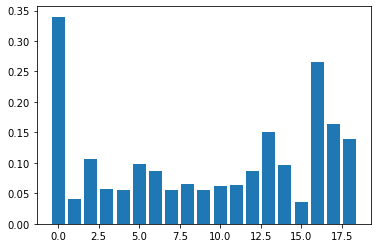

In [39]:
class_means = AVG_LOGITS.mean(dim=0).numpy()
labels = range(19)
plt.bar(labels, class_means)
plt.show()

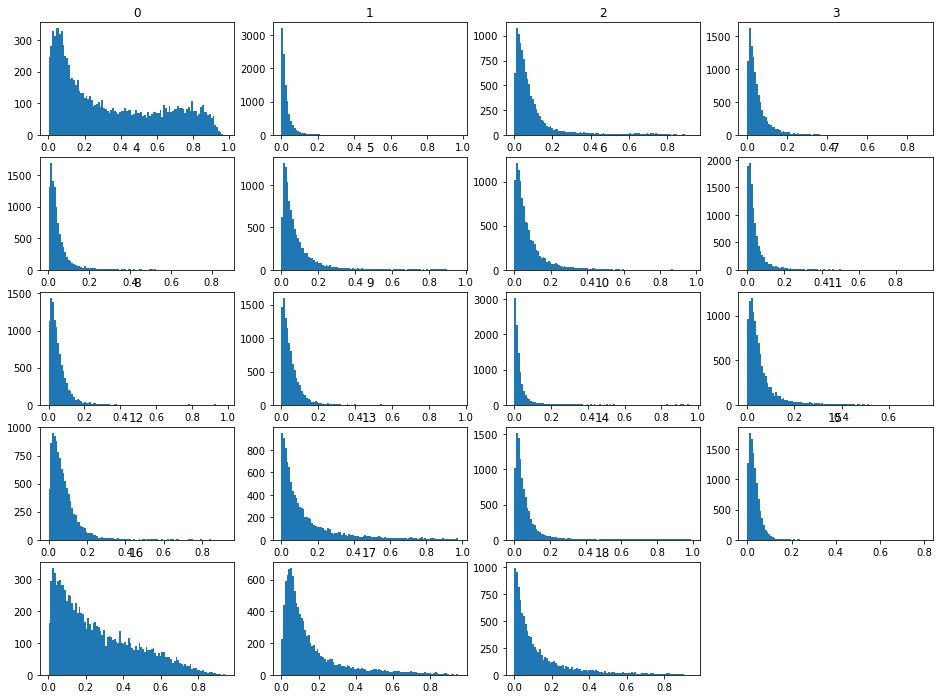

In [40]:
fig = plt.figure(figsize=(16, 12))

for i in labels:
    ax = fig.add_subplot(5,4,i+1)
    ax.hist(AVG_LOGITS[:,i].numpy(), bins=100)
    ax.set_title(i)

plt.show()

In [41]:
top_preds = AVG_LOGITS.argmax(dim=0).tolist()
top_kpreds = (-AVG_LOGITS).argsort(dim=0)[:6]
top30preds = (-AVG_LOGITS).argsort(dim=0)[30:33]
last_preds = (-AVG_LOGITS).argsort(dim=0)[-3:]
othe_preds = torch.cat([top30preds, last_preds], dim=0)
top_kvals = [[AVG_LOGITS[top_kpreds[i,j],j] for i in range(6)] for j in range(19)]
othe_vals = [[AVG_LOGITS[othe_preds[i,j],j] for i in range(6)] for j in range(19)]

In [42]:
HPA_LABEL_NAMES = {
    0: 'Nucleoplasm',
    1: 'Nuclear membrane',
    2: 'Nucleoli',
    3: 'Nucleoli fibrillar center',
    4: 'Nuclear speckles',
    5: 'Nuclear bodies',
    6: 'Endoplasmic reticulum',
    7: 'Golgi apparatus',
    8: 'Intermediate filaments',
    9: 'Actin filaments',
    10: 'Microtubules',
    11: 'Mitotic spindle',
    12: 'Centrosome',
    13: 'Plasma membrane',
    14: 'Mitochondria',
    15: 'Aggresome',
    16: 'Cytosol',
    17: 'Vesicles and punctate cytosolic patterns',
    18: 'Negative'
}

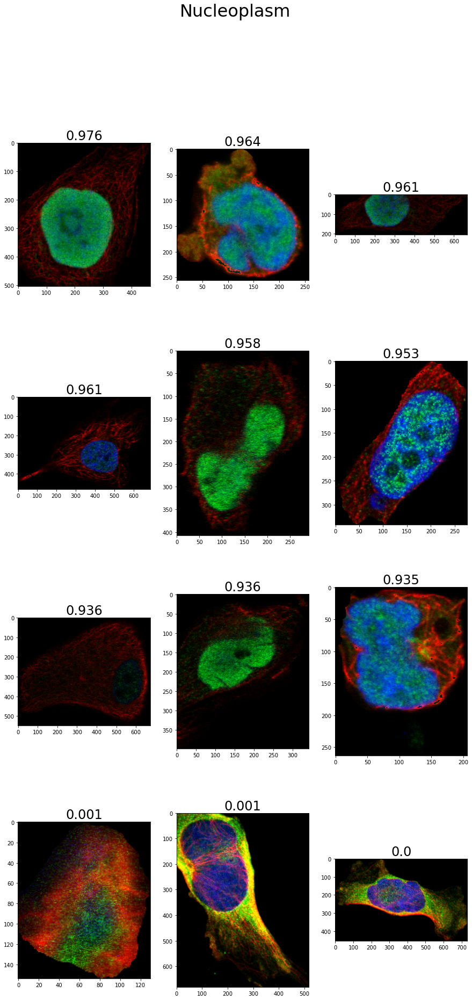

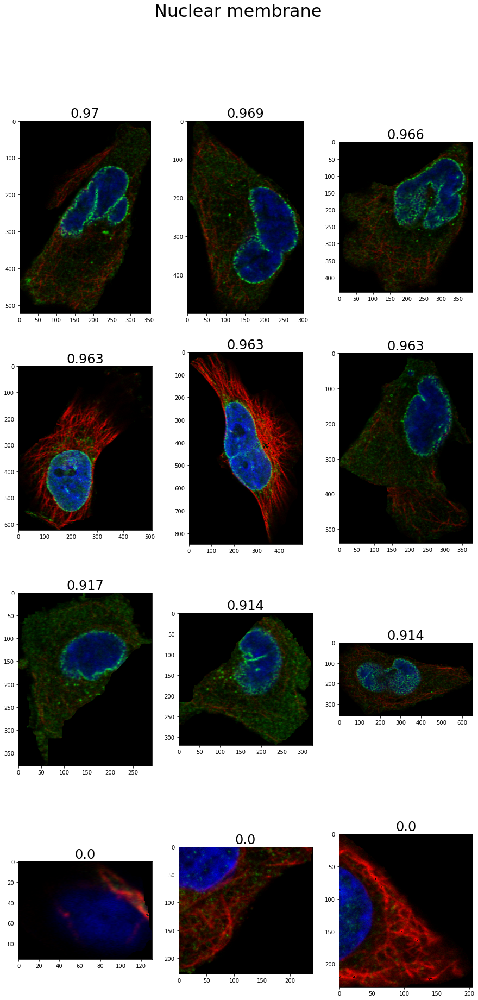

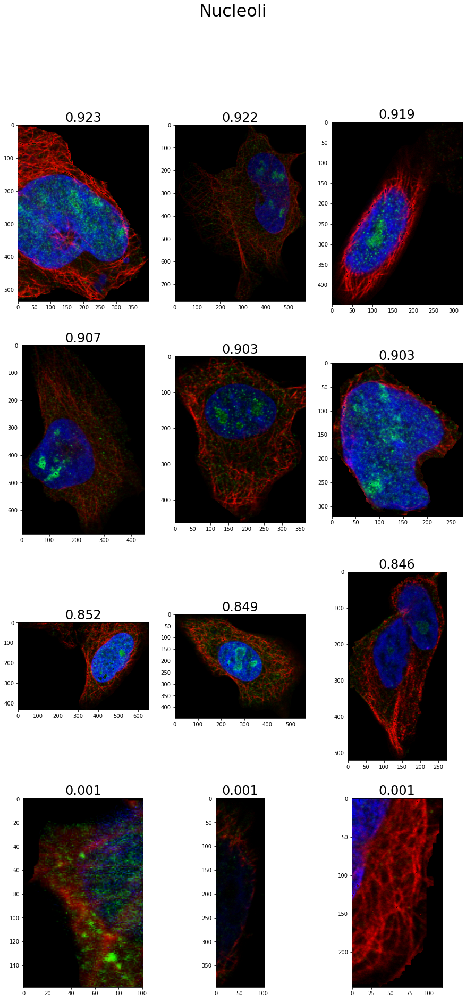

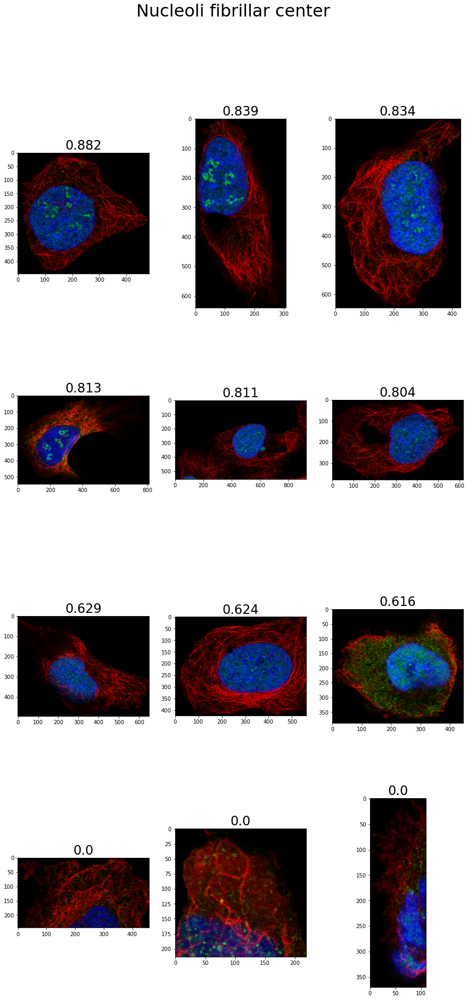

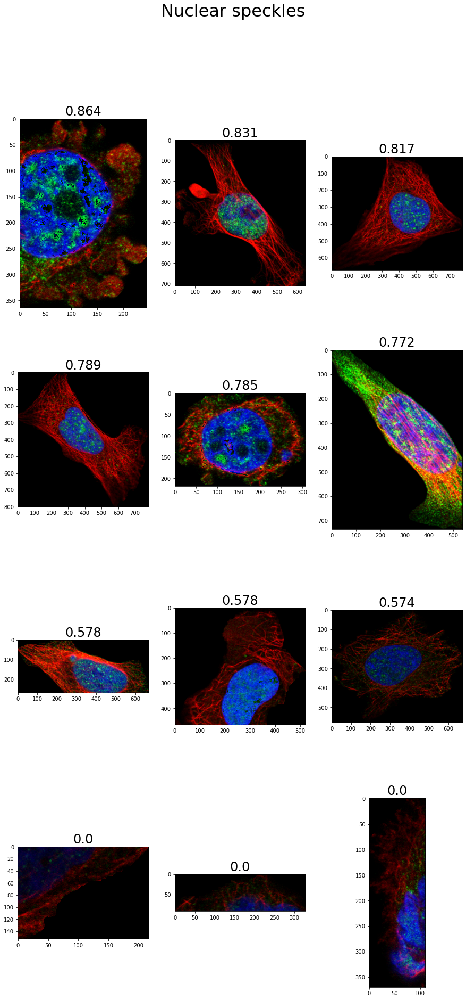

...

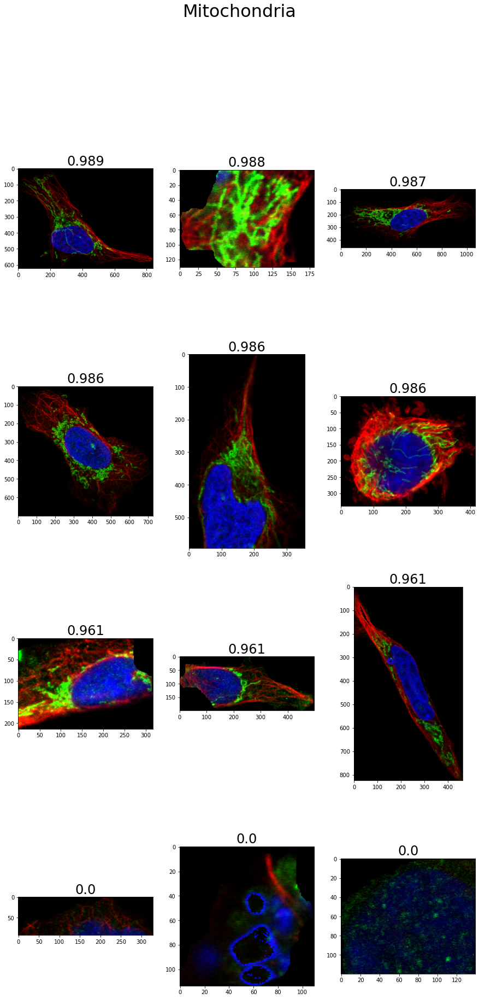

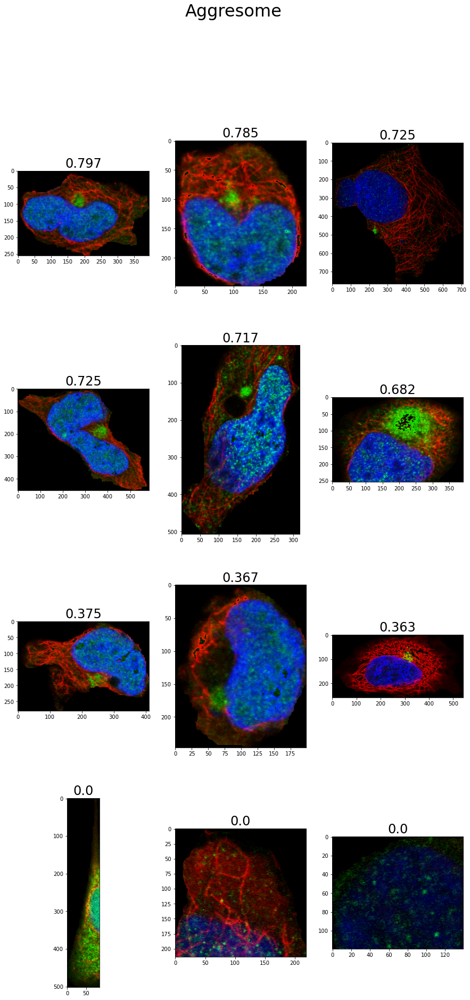

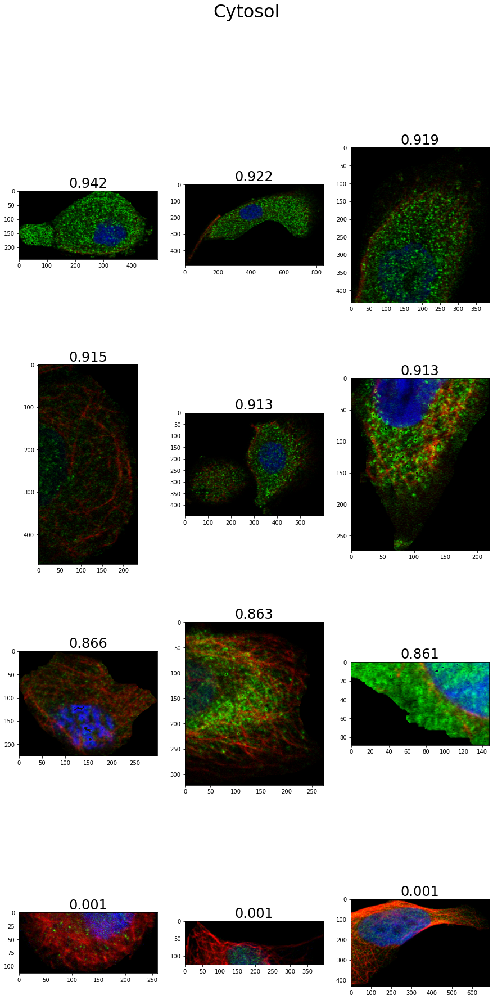

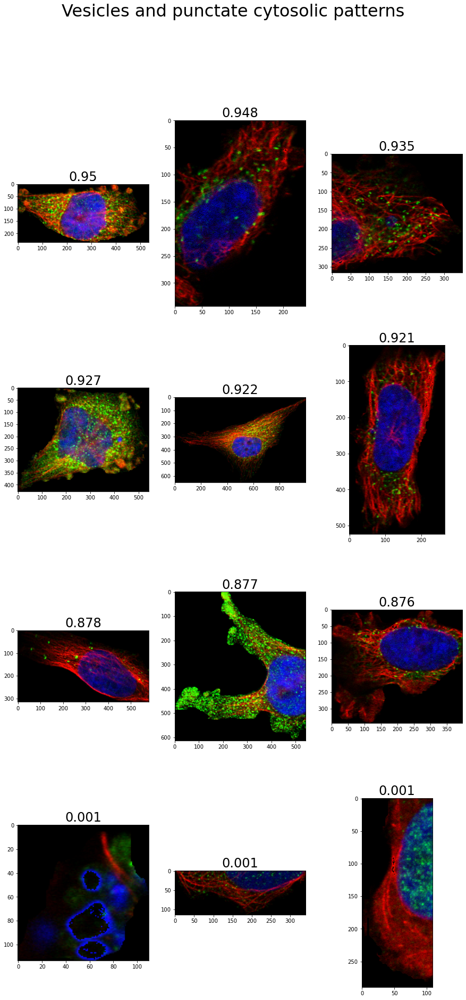

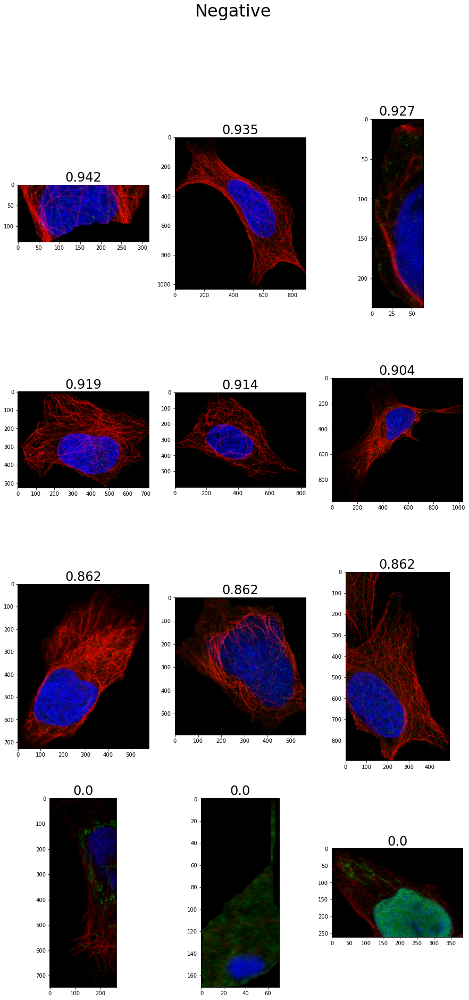

In [43]:
dataset_show = HPATestDataset(test_df, transform=None)
from pylab import rcParams
rcParams['figure.figsize'] = 15,30
rcParams['figure.titlesize'] = 32
rcParams['axes.titlesize'] = 24
rcParams['axes.labelsize'] = 20

for i in range(19):
    f, axarr = plt.subplots(4,3)
    f.suptitle(f'{HPA_LABEL_NAMES[i]}')
    for p in range(3):
        idx = top_kpreds[p,i].item()
        img = dataset_show[idx][:3]
#         img = unnorm(img)
        axarr[0,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[0,p].title.set_text(f'{np.round(top_kvals[i][p].item(), 3)}')
    for p in range(3):
        idx = top_kpreds[p+3,i].item()
        img = dataset_show[idx][:3]
#         img = unnorm(img)
        axarr[1,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[1,p].title.set_text(f'{np.round(top_kvals[i][p+3].item(), 3)}')
    for p in range(3):
        idx = othe_preds[p,i].item()
        img = dataset_show[idx][:3]
#         img = unnorm(img)
        axarr[2,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[2,p].title.set_text(f'{np.round(othe_vals[i][p].item(), 3)}')
    for p in range(3):
        idx = othe_preds[p+3,i].item()
        img = dataset_show[idx][:3]
#         img = unnorm(img)
        axarr[3,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[3,p].title.set_text(f'{np.round(othe_vals[i][p+3].item(), 3)}')